In [1]:
import numpy as np
import pandas as pd
import datetime as dt
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import style

%matplotlib inline

In [2]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Flatten

In [3]:
df = pd.read_csv('SJT-Tfr1.csv',parse_dates=['Datetime'])

In [4]:
df.head()

,ID,Datetime,RealEnergyWH,LineVoltageVRY,LineVoltageVYB,LineVoltageVBR,LineCurrentIR,LineCurrentIY,LineCurrentIB,RealPower,PowerFactor,Frequency
0,1,2006-12-16 17:24:00,874408,416.42,419.65,421.65,689.44,580.63,481.54,424113.31,-1.0,50.1
1,2,2006-12-16 17:26:00,874434,419.55,422.42,423.31,603.30,535.62,427.29,380890.97,1.0,50.1
2,3,2006-12-16 17:28:00,874444,420.47,423.36,424.67,576.12,499.41,402.67,360707.31,-1.0,50.1
3,4,2006-12-16 17:30:00,874453,414.77,417.46,419.91,641.52,540.84,442.57,391518.84,-1.0,50.1
4,5,2006-12-16 17:32:00,874463,413.01,415.77,418.76,627.82,514.14,422.16,375052.62,1.0,49.9


In [5]:
df['Date'] = pd.to_datetime(df['Datetime']).dt.date
df['Time'] = pd.to_datetime(df['Datetime']).dt.time
df['Month'] = pd.to_datetime(df['Datetime']).dt.month
df['Day'] = pd.to_datetime(df['Datetime']).dt.day_name()
#df['Hour'] = pd.to_datetime(df['Datetime']).dt.hour

In [6]:
df.head()

,ID,Datetime,RealEnergyWH,LineVoltageVRY,LineVoltageVYB,LineVoltageVBR,LineCurrentIR,LineCurrentIY,LineCurrentIB,RealPower,PowerFactor,Frequency,Date,Time,Month,Day
0,1,2006-12-16 17:24:00,874408,416.42,419.65,421.65,689.44,580.63,481.54,424113.31,-1.0,50.1,2006-12-16,17:24:00,12,Saturday
1,2,2006-12-16 17:26:00,874434,419.55,422.42,423.31,603.30,535.62,427.29,380890.97,1.0,50.1,2006-12-16,17:26:00,12,Saturday
2,3,2006-12-16 17:28:00,874444,420.47,423.36,424.67,576.12,499.41,402.67,360707.31,-1.0,50.1,2006-12-16,17:28:00,12,Saturday
3,4,2006-12-16 17:30:00,874453,414.77,417.46,419.91,641.52,540.84,442.57,391518.84,-1.0,50.1,2006-12-16,17:30:00,12,Saturday
4,5,2006-12-16 17:32:00,874463,413.01,415.77,418.76,627.82,514.14,422.16,375052.62,1.0,49.9,2006-12-16,17:32:00,12,Saturday


In [7]:
from dataprep.eda import *

  0%|                                                                                          | 0/512 [00:00<…


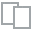
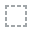
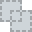
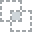
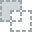
...
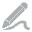
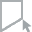
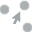
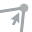
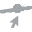

In [8]:
plot(df.drop(['ID', 'Datetime','PowerFactor','Frequency','Date','Time','Month','Day'], axis = 1))

  0%|                                                                                         | 0/1579 [00:00<…

C:\Users\vaish\AppData\Local\Programs\Python\Python310\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
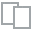
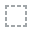
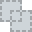
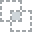
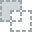
...
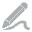
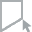
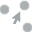
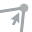
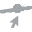

In [9]:
create_report(df.drop(['ID', 'Datetime','PowerFactor','Frequency','Date','Time','Month','Day'], axis = 1))

In [10]:
df.Month.unique()

array([12,  1,  2,  3], dtype=int64)

In [11]:
df.Date.nunique()

80

In [12]:
df.index = pd.to_datetime(df['Datetime'], format='%d.%m.%Y %H:%M:%S')
df.head()

,ID,Datetime,RealEnergyWH,LineVoltageVRY,LineVoltageVYB,LineVoltageVBR,LineCurrentIR,LineCurrentIY,LineCurrentIB,RealPower,PowerFactor,Frequency,Date,Time,Month,Day
Datetime,,,,,,,,,,,,,,,,
2006-12-16 17:24:00,1,2006-12-16 17:24:00,874408,416.42,419.65,421.65,689.44,580.63,481.54,424113.31,-1.0,50.1,2006-12-16,17:24:00,12,Saturday
2006-12-16 17:26:00,2,2006-12-16 17:26:00,874434,419.55,422.42,423.31,603.30,535.62,427.29,380890.97,1.0,50.1,2006-12-16,17:26:00,12,Saturday
2006-12-16 17:28:00,3,2006-12-16 17:28:00,874444,420.47,423.36,424.67,576.12,499.41,402.67,360707.31,-1.0,50.1,2006-12-16,17:28:00,12,Saturday
2006-12-16 17:30:00,4,2006-12-16 17:30:00,874453,414.77,417.46,419.91,641.52,540.84,442.57,391518.84,-1.0,50.1,2006-12-16,17:30:00,12,Saturday
2006-12-16 17:32:00,5,2006-12-16 17:32:00,874463,413.01,415.77,418.76,627.82,514.14,422.16,375052.62,1.0,49.9,2006-12-16,17:32:00,12,Saturday


In [13]:
df.dtypes

ID                         int64
Datetime          datetime64[ns]
RealEnergyWH               int64
LineVoltageVRY           float64
LineVoltageVYB           float64
LineVoltageVBR           float64
LineCurrentIR            float64
LineCurrentIY            float64
LineCurrentIB            float64
RealPower                float64
PowerFactor              float64
Frequency                float64
Date                      object
Time                      object
Month                      int64
Day                       object
dtype: object

# DataSet Visualisation

In [14]:
from plotly import __version__

import cufflinks as cf

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot

In [15]:
init_notebook_mode(connected=True)

cf.go_offline()

In [16]:
df['RealPower'].iplot()

In [17]:
df['RealPower'].iplot(kind='hist')

In [18]:
df.drop(['ID','PowerFactor','Frequency','Month','Day'], axis = 1).sum().iplot(kind='bar')#count

In [19]:
from matplotlib import rcParams

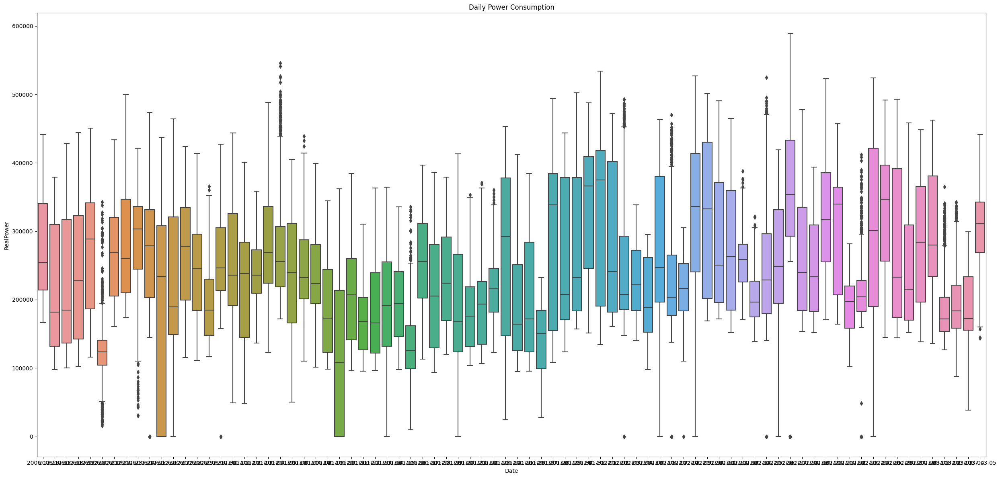

In [20]:
rcParams['figure.figsize'] = 25, 12
sns.boxplot(x = df['Date'], y = df['RealPower'], data = df)
plt.title('Daily Power Consumption')
plt.tight_layout()

Text(0.5, 1.0, 'Monthly Power Consumption')

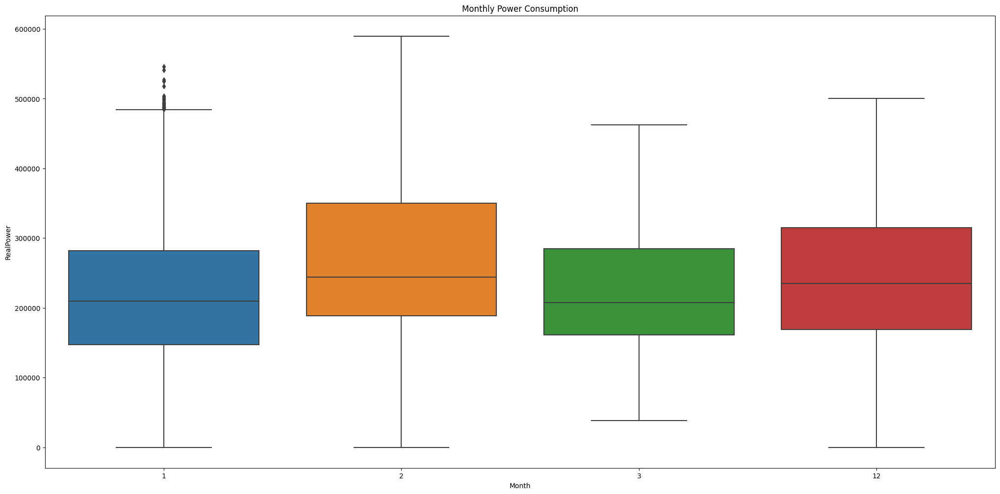

In [21]:
rcParams['figure.figsize'] = 25, 12
sns.boxplot(x = df['Month'], y = df['RealPower'], data = df)
plt.title('Monthly Power Consumption')

Text(0.5, 1.0, 'Day Wise Power Consumption')

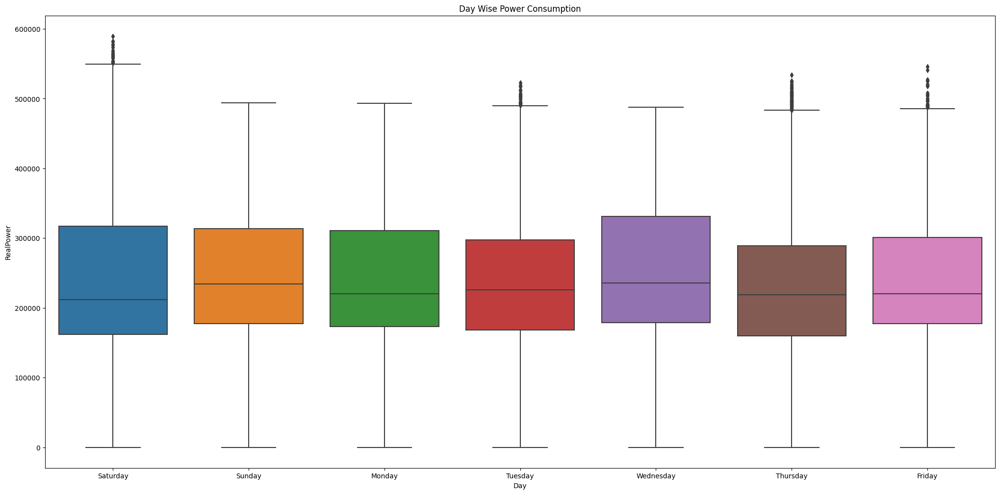

In [22]:
rcParams['figure.figsize'] = 25, 12
sns.boxplot(x = df['Day'], y = df['RealPower'], data = df)
plt.title('Day Wise Power Consumption')

In [23]:
table = df.pivot_table(values = 'RealPower', index = "Day", columns="Month")

In [24]:
table

Month,1,2,3,12
Day,,,,
Friday,221009.130309,262557.396260,190294.369556,256070.065035
Monday,226159.817567,250806.961292,300555.333917,244325.297840
Saturday,189826.900024,297653.011076,198674.002056,243579.924646
Sunday,228619.954965,272726.687250,186904.371125,255633.990801
Thursday,220736.154319,249320.647514,294213.753347,197616.418542
Tuesday,205708.842100,273778.761417,NaN,216044.447153
Wednesday,241137.419475,251324.352854,NaN,252295.582132


<AxesSubplot: xlabel='Month', ylabel='Day'>

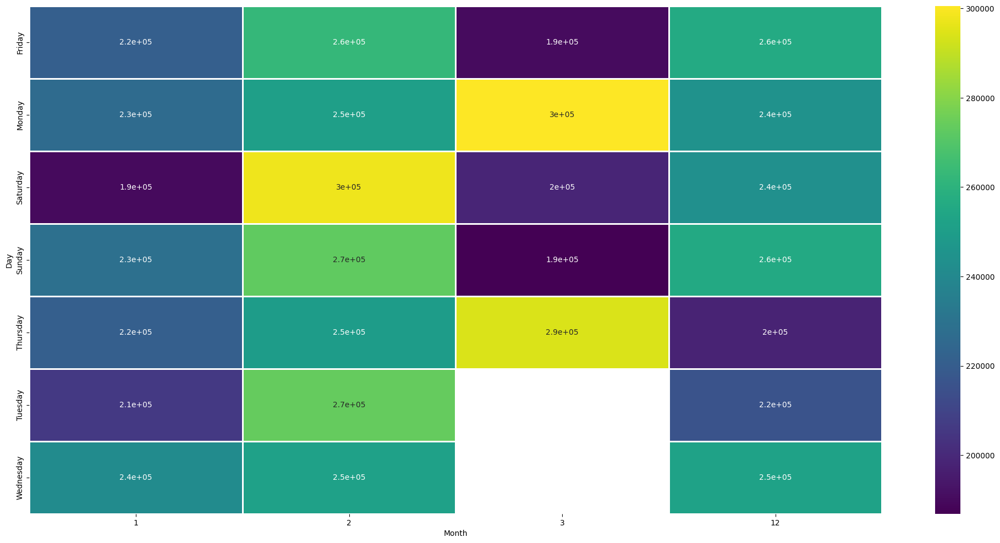

In [25]:
sns.heatmap(table, annot=True, linewidths=1, cmap='viridis')

In [26]:
df.columns

Index(['ID', 'Datetime', 'RealEnergyWH', 'LineVoltageVRY', 'LineVoltageVYB',
       'LineVoltageVBR', 'LineCurrentIR', 'LineCurrentIY', 'LineCurrentIB',
       'RealPower', 'PowerFactor', 'Frequency', 'Date', 'Time', 'Month',
       'Day'],
      dtype='object')

In [27]:
df.head()

,ID,Datetime,RealEnergyWH,LineVoltageVRY,LineVoltageVYB,LineVoltageVBR,LineCurrentIR,LineCurrentIY,LineCurrentIB,RealPower,PowerFactor,Frequency,Date,Time,Month,Day
Datetime,,,,,,,,,,,,,,,,
2006-12-16 17:24:00,1,2006-12-16 17:24:00,874408,416.42,419.65,421.65,689.44,580.63,481.54,424113.31,-1.0,50.1,2006-12-16,17:24:00,12,Saturday
2006-12-16 17:26:00,2,2006-12-16 17:26:00,874434,419.55,422.42,423.31,603.30,535.62,427.29,380890.97,1.0,50.1,2006-12-16,17:26:00,12,Saturday
2006-12-16 17:28:00,3,2006-12-16 17:28:00,874444,420.47,423.36,424.67,576.12,499.41,402.67,360707.31,-1.0,50.1,2006-12-16,17:28:00,12,Saturday
2006-12-16 17:30:00,4,2006-12-16 17:30:00,874453,414.77,417.46,419.91,641.52,540.84,442.57,391518.84,-1.0,50.1,2006-12-16,17:30:00,12,Saturday
2006-12-16 17:32:00,5,2006-12-16 17:32:00,874463,413.01,415.77,418.76,627.82,514.14,422.16,375052.62,1.0,49.9,2006-12-16,17:32:00,12,Saturday


# MODEL FOR PREDICTION

In [28]:
# preparing independent and dependent features
def prepare_data(timeseries_data, n_steps):
    X, y =[],[]
    for i in range(len(timeseries_data)):
        # find the end of this pattern
        end_ix = i + n_steps
        # check if we are beyond the sequence
        if end_ix > len(timeseries_data)-1:
            break
        # gather input and output parts of the pattern
        seq_x, seq_y = timeseries_data[i:end_ix], timeseries_data[end_ix]
        X.append(seq_x)
        y.append(seq_y)
    return np.array(X), np.array(y)

## For Daily basis Prediction

In [29]:
data= df.drop(['ID', 'Datetime', 'RealEnergyWH', 'LineVoltageVRY', 'LineVoltageVYB',
       'LineVoltageVBR', 'LineCurrentIR', 'LineCurrentIY', 'LineCurrentIB', 
                'PowerFactor', 'Frequency', 'Date', 'Time', 'Month',
       'Day'], axis = 1)

In [30]:
data.index = pd.to_datetime(df['Date'], format='%Y.%m.%d')
data.head()

,RealPower
Date,
2006-12-16,424113.31
2006-12-16,380890.97
2006-12-16,360707.31
2006-12-16,391518.84
2006-12-16,375052.62


In [31]:
data.shape

(56792, 1)

In [32]:
### Data Set For daily predictions
DataSet_Daily = data.resample('D').mean()

In [33]:
print(DataSet_Daily.size)
print(DataSet_Daily.shape)

80
(80, 1)


In [34]:
DataSet_Daily.head()

,RealPower
Date,
2006-12-16,278811.959545
2006-12-17,219499.872986
2006-12-18,217916.762556
2006-12-19,234796.073264
2006-12-20,274878.817597


In [35]:
# define input sequence
timeseries_data_daily = np.array(DataSet_Daily).reshape(DataSet_Daily.size, )
n_steps = 3
# split into samples
X1, y1 = prepare_data(timeseries_data_daily, n_steps)

In [36]:
# reshape from [samples, timesteps] into [samples, timesteps, features]
n_features = 1
X1 = X1.reshape((X1.shape[0], X1.shape[1], n_features))

In [37]:
# define model
model_daily = Sequential()
model_daily.add(LSTM(50, activation='relu', return_sequences=True, input_shape=(n_steps, n_features)))
model_daily.add(LSTM(50, activation='relu'))
model_daily.add(Dense(1))
model_daily.compile(optimizer='adam', loss='mse')
# fit model
model_daily.fit(X1, y1, epochs=300, verbose=1)

Epoch 1/300
3/3 [==============================] - 3s 8ms/step - loss: 62066282496.0000
Epoch 2/300
3/3 [==============================] - 0s 7ms/step - loss: 60329160704.0000
Epoch 3/300
3/3 [==============================] - 0s 4ms/step - loss: 58957942784.0000
Epoch 4/300
3/3 [==============================] - 0s 4ms/step - loss: 57773916160.0000
Epoch 5/300
3/3 [==============================] - 0s 1ms/step - loss: 57225900032.0000
Epoch 6/300
3/3 [==============================] - 0s 496us/step - loss: 57038069760.0000
Epoch 7/300
3/3 [==============================] - 0s 5ms/step - loss: 56131035136.0000
Epoch 8/300
3/3 [==============================] - 0s 8ms/step - loss: 55040569344.0000
Epoch 9/300
3/3 [==============================] - 0s 5ms/step - loss: 53376942080.0000
Epoch 10/300
3/3 [==============================] - 0s 2ms/step - loss: 52030431232.0000
Epoch 11/300
3/3 [==============================] - 0s 5ms/step - loss: 51323056128.0000
Epoch 12/300
3/3 [==========

3/3 [==============================] - 0s 5ms/step - loss: 2834224128.0000
Epoch 186/300
3/3 [==============================] - 0s 3ms/step - loss: 2841428736.0000
Epoch 187/300
3/3 [==============================] - 0s 6ms/step - loss: 2867357952.0000
Epoch 188/300
3/3 [==============================] - 0s 5ms/step - loss: 2849153024.0000
Epoch 189/300
3/3 [==============================] - 0s 5ms/step - loss: 2840135424.0000
Epoch 190/300
3/3 [==============================] - 0s 5ms/step - loss: 2820140288.0000
Epoch 191/300
3/3 [==============================] - 0s 5ms/step - loss: 2822559744.0000
Epoch 192/300
3/3 [==============================] - 0s 5ms/step - loss: 2774781696.0000
Epoch 193/300
3/3 [==============================] - 0s 5ms/step - loss: 2749297408.0000
Epoch 194/300
3/3 [==============================] - 0s 5ms/step - loss: 2749942272.0000
Epoch 195/300
3/3 [==============================] - 0s 499us/step - loss: 2759164416.0000
Epoch 196/300
3/3 [==============

3/3 [==============================] - 0s 5ms/step - loss: 2873421568.0000
Epoch 278/300
3/3 [==============================] - 0s 4ms/step - loss: 2861262336.0000
Epoch 279/300
3/3 [==============================] - 0s 4ms/step - loss: 2850044160.0000
Epoch 280/300
3/3 [==============================] - 0s 5ms/step - loss: 2850156288.0000
Epoch 281/300
3/3 [==============================] - 0s 5ms/step - loss: 2849438720.0000
Epoch 282/300
3/3 [==============================] - 0s 4ms/step - loss: 2850067712.0000
Epoch 283/300
3/3 [==============================] - 0s 3ms/step - loss: 2859287552.0000
Epoch 284/300
3/3 [==============================] - 0s 4ms/step - loss: 2859721472.0000
Epoch 285/300
3/3 [==============================] - 0s 4ms/step - loss: 2863686912.0000
Epoch 286/300
3/3 [==============================] - 0s 8ms/step - loss: 2853530624.0000
Epoch 287/300
3/3 [==============================] - 0s 11ms/step - loss: 2841646592.0000
Epoch 288/300
3/3 [===============

In [38]:
## Input
#x_input = timeseries_data_daily[-3:]

## Minute wise Prediction

In [39]:
DataSet_min= df.drop(['ID', 'Datetime', 'RealEnergyWH', 'LineVoltageVRY', 'LineVoltageVYB',
       'LineVoltageVBR', 'LineCurrentIR', 'LineCurrentIY', 'LineCurrentIB', 
                'PowerFactor', 'Frequency', 'Date', 'Time', 'Month',
       'Day'], axis = 1)

In [40]:
DataSet_min.index = pd.to_datetime(df['Datetime'], format='%d.%m.%Y %H:%M:%S')
DataSet_min.head()

,RealPower
Datetime,
2006-12-16 17:24:00,424113.31
2006-12-16 17:26:00,380890.97
2006-12-16 17:28:00,360707.31
2006-12-16 17:30:00,391518.84
2006-12-16 17:32:00,375052.62


In [41]:
# define input sequence
timeseries_data_min = np.array(DataSet_min).reshape(DataSet_min.size, )
n_steps = 3
# split into samples
X2, y2 = prepare_data(timeseries_data_min, n_steps)

In [42]:
# reshape from [samples, timesteps] into [samples, timesteps, features]
n_features = 1
X2 = X2.reshape((X2.shape[0], X2.shape[1], n_features))

In [43]:
# define model
model_min = Sequential()
model_min.add(LSTM(50, activation='relu', return_sequences=True, input_shape=(n_steps, n_features)))
model_min.add(LSTM(50, activation='relu'))
model_min.add(Dense(1))
model_min.compile(optimizer='adam', loss='mse')
# fit model
model_min.fit(X2, y2, epochs=300, verbose=1)

Epoch 1/300
1775/1775 [==============================] - 9s 4ms/step - loss: 2921697024.0000
Epoch 2/300
1775/1775 [==============================] - 7s 4ms/step - loss: 442651008.0000
Epoch 3/300
1775/1775 [==============================] - 6s 4ms/step - loss: 452517504.0000
Epoch 4/300
1775/1775 [==============================] - 7s 4ms/step - loss: 482343776.0000
Epoch 5/300
1775/1775 [==============================] - 6s 4ms/step - loss: 396135968.0000
Epoch 6/300
1775/1775 [==============================] - 6s 4ms/step - loss: 373817504.0000
Epoch 7/300
1775/1775 [==============================] - 7s 4ms/step - loss: 370464384.0000
Epoch 8/300
1775/1775 [==============================] - 7s 4ms/step - loss: 387138496.0000
Epoch 9/300
1775/1775 [==============================] - 7s 4ms/step - loss: 391920704.0000
Epoch 10/300
1775/1775 [==============================] - 7s 4ms/step - loss: 376166688.0000
Epoch 11/300
1775/1775 [==============================] - 6s 4ms/step - loss: 

1775/1775 [==============================] - 6s 3ms/step - loss: 325993568.0000
Epoch 177/300
1775/1775 [==============================] - 7s 4ms/step - loss: 325483744.0000
Epoch 178/300
1775/1775 [==============================] - 6s 3ms/step - loss: 325818304.0000
Epoch 179/300
1775/1775 [==============================] - 6s 3ms/step - loss: 325194752.0000
Epoch 180/300
1775/1775 [==============================] - 6s 3ms/step - loss: 324510208.0000
Epoch 181/300
1775/1775 [==============================] - 6s 3ms/step - loss: 325647648.0000
Epoch 182/300
1775/1775 [==============================] - 6s 4ms/step - loss: 325183968.0000
Epoch 183/300
1775/1775 [==============================] - 6s 4ms/step - loss: 325848096.0000
Epoch 184/300
1775/1775 [==============================] - 6s 4ms/step - loss: 325659200.0000
Epoch 185/300
1775/1775 [==============================] - 6s 4ms/step - loss: 324984416.0000
Epoch 186/300
1775/1775 [==============================] - 6s 4ms/step - l

## Weekly Prediction

In [44]:
DataSet_Weekly = data.resample('W').mean()

In [45]:
DataSet_Weekly

,RealPower
Date,
2006-12-17,232292.675969
2006-12-24,241796.175351
2006-12-31,237857.647579
2007-01-07,249978.200004
2007-01-14,183747.163887
2007-01-21,200361.979688
2007-01-28,215235.510966
2007-02-04,279380.198633
2007-02-11,259768.388087


In [46]:
# define input sequence (reshaping the model and converting to array)
timeseries_data_week = np.array(DataSet_Weekly).reshape(DataSet_Weekly.size, )
n_steps = 3
# split into samples
X3, y3 = prepare_data(timeseries_data_week, n_steps)

In [47]:
# reshape from [samples, timesteps] into [samples, timesteps, features]
n_features = 1
X3 = X3.reshape((X3.shape[0], X3.shape[1], n_features))

In [48]:
# define model
model_week = Sequential()
model_week.add(LSTM(50, activation='relu', return_sequences=True, input_shape=(n_steps, n_features)))
model_week.add(LSTM(50, activation='relu'))
model_week.add(Dense(1))
model_week.compile(optimizer='adam', loss='mse')
# fit model
model_week.fit(X3, y3, epochs=300, verbose=1)

Epoch 1/300
1/1 [==============================] - 2s 2s/step - loss: 59562418176.0000
Epoch 2/300
1/1 [==============================] - 0s 7ms/step - loss: 59407486976.0000
Epoch 3/300
1/1 [==============================] - 0s 5ms/step - loss: 59257159680.0000
Epoch 4/300
1/1 [==============================] - 0s 8ms/step - loss: 59072937984.0000
Epoch 5/300
1/1 [==============================] - 0s 9ms/step - loss: 58883612672.0000
Epoch 6/300
1/1 [==============================] - 0s 4ms/step - loss: 58624008192.0000
Epoch 7/300
1/1 [==============================] - 0s 6ms/step - loss: 58475962368.0000
Epoch 8/300
1/1 [==============================] - 0s 7ms/step - loss: 58354147328.0000
Epoch 9/300
1/1 [==============================] - 0s 6ms/step - loss: 58230530048.0000
Epoch 10/300
1/1 [==============================] - 0s 6ms/step - loss: 58103242752.0000
Epoch 11/300
1/1 [==============================] - 0s 7ms/step - loss: 57972137984.0000
Epoch 12/300
1/1 [=============

1/1 [==============================] - 0s 5ms/step - loss: 17618071552.0000
Epoch 94/300
1/1 [==============================] - 0s 6ms/step - loss: 16366349312.0000
Epoch 95/300
1/1 [==============================] - 0s 5ms/step - loss: 15479824384.0000
Epoch 96/300
1/1 [==============================] - 0s 6ms/step - loss: 14598055936.0000
Epoch 97/300
1/1 [==============================] - 0s 6ms/step - loss: 13720385536.0000
Epoch 98/300
1/1 [==============================] - 0s 6ms/step - loss: 12852647936.0000
Epoch 99/300
1/1 [==============================] - 0s 6ms/step - loss: 11998238720.0000
Epoch 100/300
1/1 [==============================] - 0s 2ms/step - loss: 11160628224.0000
Epoch 101/300
1/1 [==============================] - 0s 3ms/step - loss: 10343016448.0000
Epoch 102/300
1/1 [==============================] - 0s 6ms/step - loss: 9548516352.0000
Epoch 103/300
1/1 [==============================] - 0s 4ms/step - loss: 8778101760.0000
Epoch 104/300
1/1 [=============

1/1 [==============================] - 0s 5ms/step - loss: 1615926784.0000
Epoch 186/300
1/1 [==============================] - 0s 5ms/step - loss: 1615619456.0000
Epoch 187/300
1/1 [==============================] - 0s 4ms/step - loss: 1615304192.0000
Epoch 188/300
1/1 [==============================] - 0s 3ms/step - loss: 1614981504.0000
Epoch 189/300
1/1 [==============================] - 0s 5ms/step - loss: 1614651264.0000
Epoch 190/300
1/1 [==============================] - 0s 4ms/step - loss: 1614314368.0000
Epoch 191/300
1/1 [==============================] - 0s 5ms/step - loss: 1613972608.0000
Epoch 192/300
1/1 [==============================] - 0s 8ms/step - loss: 1613626112.0000
Epoch 193/300
1/1 [==============================] - 0s 5ms/step - loss: 1613311104.0000
Epoch 194/300
1/1 [==============================] - 0s 5ms/step - loss: 1612931328.0000
Epoch 195/300
1/1 [==============================] - 0s 2ms/step - loss: 1612586112.0000
Epoch 196/300
1/1 [================

1/1 [==============================] - 0s 5ms/step - loss: 1569190912.0000
Epoch 278/300
1/1 [==============================] - 0s 6ms/step - loss: 1568546048.0000
Epoch 279/300
1/1 [==============================] - 0s 6ms/step - loss: 1567901312.0000
Epoch 280/300
1/1 [==============================] - 0s 6ms/step - loss: 1567250688.0000
Epoch 281/300
1/1 [==============================] - 0s 5ms/step - loss: 1566591232.0000
Epoch 282/300
1/1 [==============================] - 0s 6ms/step - loss: 1565921536.0000
Epoch 283/300
1/1 [==============================] - 0s 5ms/step - loss: 1565241600.0000
Epoch 284/300
1/1 [==============================] - 0s 6ms/step - loss: 1564552448.0000
Epoch 285/300
1/1 [==============================] - 0s 5ms/step - loss: 1563857280.0000
Epoch 286/300
1/1 [==============================] - 0s 5ms/step - loss: 1563207808.0000
Epoch 287/300
1/1 [==============================] - 0s 6ms/step - loss: 1562479616.0000
Epoch 288/300
1/1 [================

## Monthly Prediction

In [49]:
DataSet_Month = data.resample('M').mean()

In [50]:
DataSet_Month

,RealPower
Date,
2006-12-31,239198.030925
2007-01-31,219541.901748
2007-02-28,265452.545380
2007-03-31,228395.682589


In [51]:
# define input sequence
timeseries_data_month = np.array(DataSet_Month).reshape(DataSet_Month.size, )
n_steps = 3
# split into samples
X4, y4 = prepare_data(timeseries_data_month, n_steps)

In [52]:
# reshape from [samples, timesteps] into [samples, timesteps, features]
n_features = 1
X4 = X4.reshape((X4.shape[0], X4.shape[1], n_features))

In [53]:
# define model
model_month = Sequential()
model_month.add(LSTM(50, activation='relu', return_sequences=True, input_shape=(n_steps, n_features)))
model_month.add(LSTM(50, activation='relu'))
model_month.add(Dense(1))
model_month.compile(optimizer='adam', loss='mse')
# fit model
model_month.fit(X4, y4, epochs=300, verbose=1)

Epoch 1/300
1/1 [==============================] - 2s 2s/step - loss: 53856411648.0000
Epoch 2/300
1/1 [==============================] - 0s 3ms/step - loss: 53681811456.0000
Epoch 3/300
1/1 [==============================] - 0s 6ms/step - loss: 52863401984.0000
Epoch 4/300
1/1 [==============================] - 0s 7ms/step - loss: 53382340608.0000
Epoch 5/300
1/1 [==============================] - 0s 6ms/step - loss: 53251203072.0000
Epoch 6/300
1/1 [==============================] - 0s 6ms/step - loss: 52624175104.0000
Epoch 7/300
1/1 [==============================] - 0s 6ms/step - loss: 52556845056.0000
Epoch 8/300
1/1 [==============================] - 0s 5ms/step - loss: 52487319552.0000
Epoch 9/300
1/1 [==============================] - 0s 5ms/step - loss: 52416020480.0000
Epoch 10/300
1/1 [==============================] - 0s 6ms/step - loss: 52343234560.0000
Epoch 11/300
1/1 [==============================] - 0s 8ms/step - loss: 52269162496.0000
Epoch 12/300
1/1 [=============

1/1 [==============================] - 0s 2ms/step - loss: 50473988096.0000
Epoch 185/300
1/1 [==============================] - 0s 8ms/step - loss: 50443628544.0000
Epoch 186/300
1/1 [==============================] - 0s 8ms/step - loss: 50412732416.0000
Epoch 187/300
1/1 [==============================] - 0s 5ms/step - loss: 50381295616.0000
Epoch 188/300
1/1 [==============================] - 0s 6ms/step - loss: 50349309952.0000
Epoch 189/300
1/1 [==============================] - 0s 5ms/step - loss: 50316754944.0000
Epoch 190/300
1/1 [==============================] - 0s 4ms/step - loss: 50283626496.0000
Epoch 191/300
1/1 [==============================] - 0s 4ms/step - loss: 50249904128.0000
Epoch 192/300
1/1 [==============================] - 0s 3ms/step - loss: 50215591936.0000
Epoch 193/300
1/1 [==============================] - 0s 8ms/step - loss: 46426513408.0000
Epoch 194/300
1/1 [==============================] - 0s 4ms/step - loss: 46382837760.0000
Epoch 195/300
1/1 [=====

## Hourly Prediction

In [54]:
DataSet_Hour = DataSet_min.resample('H').mean()

In [55]:
DataSet_Hour

,RealPower
Datetime,
2006-12-16 17:00:00,387678.406111
2006-12-16 18:00:00,346712.793667
2006-12-16 19:00:00,351016.382333
2006-12-16 20:00:00,269396.553667
2006-12-16 21:00:00,238127.060333
...,...
2007-03-05 10:00:00,317304.344000
2007-03-05 11:00:00,343620.377000
2007-03-05 12:00:00,361577.836667


In [56]:
# define input sequence
timeseries_data_hour = np.array(DataSet_Hour).reshape(DataSet_Hour.size, )
n_steps = 3
# split into samples
X5, y5 = prepare_data(timeseries_data_hour, n_steps)

In [57]:
# reshape from [samples, timesteps] into [samples, timesteps, features]
n_features = 1
X5 = X5.reshape((X5.shape[0], X5.shape[1], n_features))

In [58]:
# define model
model_hour = Sequential()
model_hour.add(LSTM(50, activation='relu', return_sequences=True, input_shape=(n_steps, n_features)))
model_hour.add(LSTM(50, activation='relu'))
model_hour.add(Dense(1))
model_hour.compile(optimizer='adam', loss='mse')
# fit model
model_hour.fit(X5, y5, epochs=300, verbose=1)

Epoch 1/300
60/60 [==============================] - 3s 4ms/step - loss: 57666437120.0000
Epoch 2/300
60/60 [==============================] - 0s 3ms/step - loss: 15490291712.0000
Epoch 3/300
60/60 [==============================] - 0s 3ms/step - loss: 3850198784.0000
Epoch 4/300
60/60 [==============================] - 0s 4ms/step - loss: 3820169984.0000
Epoch 5/300
60/60 [==============================] - 0s 3ms/step - loss: 3777101824.0000
Epoch 6/300
60/60 [==============================] - 0s 3ms/step - loss: 3627695360.0000
Epoch 7/300
60/60 [==============================] - 0s 3ms/step - loss: 3442056448.0000
Epoch 8/300
60/60 [==============================] - 0s 4ms/step - loss: 2897340160.0000
Epoch 9/300
60/60 [==============================] - 0s 4ms/step - loss: 2988484352.0000
Epoch 10/300
60/60 [==============================] - 0s 4ms/step - loss: 2592280832.0000
Epoch 11/300
60/60 [==============================] - 0s 3ms/step - loss: 2355044608.0000
Epoch 12/300
60/6

60/60 [==============================] - 0s 4ms/step - loss: 1370346624.0000
Epoch 93/300
60/60 [==============================] - 0s 4ms/step - loss: 1383700480.0000
Epoch 94/300
60/60 [==============================] - 0s 4ms/step - loss: 1400504192.0000
Epoch 95/300
60/60 [==============================] - 0s 4ms/step - loss: 1413508480.0000
Epoch 96/300
60/60 [==============================] - 0s 4ms/step - loss: 1360486016.0000
Epoch 97/300
60/60 [==============================] - 0s 4ms/step - loss: 1383377664.0000
Epoch 98/300
60/60 [==============================] - 0s 3ms/step - loss: 1366802304.0000
Epoch 99/300
60/60 [==============================] - 0s 4ms/step - loss: 1350825856.0000
Epoch 100/300
60/60 [==============================] - 0s 4ms/step - loss: 1411742336.0000
Epoch 101/300
60/60 [==============================] - 0s 4ms/step - loss: 1358112768.0000
Epoch 102/300
60/60 [==============================] - 0s 4ms/step - loss: 1399276288.0000
Epoch 103/300
60/60 

60/60 [==============================] - 0s 4ms/step - loss: 1319519360.0000
Epoch 273/300
60/60 [==============================] - 0s 4ms/step - loss: 1283682688.0000
Epoch 274/300
60/60 [==============================] - 0s 4ms/step - loss: 1331092480.0000
Epoch 275/300
60/60 [==============================] - 0s 4ms/step - loss: 1275298432.0000
Epoch 276/300
60/60 [==============================] - 0s 4ms/step - loss: 1283888256.0000
Epoch 277/300
60/60 [==============================] - 0s 4ms/step - loss: 1297208192.0000
Epoch 278/300
60/60 [==============================] - 0s 4ms/step - loss: 1286565760.0000
Epoch 279/300
60/60 [==============================] - 0s 4ms/step - loss: 1329931008.0000
Epoch 280/300
60/60 [==============================] - 0s 4ms/step - loss: 1323447680.0000
Epoch 281/300
60/60 [==============================] - 0s 4ms/step - loss: 1280005888.0000
Epoch 282/300
60/60 [==============================] - 0s 4ms/step - loss: 1283693568.0000
Epoch 283/300

##  Prediction Function

In [59]:
def prediction(x_input, str, T, model,lst_output):
    temp_input=list(x_input)
    i=0
    while(i<=T):
    
        if(len(temp_input)>3):
            x_input=np.array(temp_input[1:])
            x_input = x_input.reshape((1, n_steps, n_features))
            yhat = model.predict(x_input, verbose=0)
            print(str, " {} Power Consumption :{}".format(i,yhat))
            temp_input.append(yhat[0][0])
            temp_input=temp_input[1:]
            lst_output.append(yhat[0][0])
            i=i+1
        else:
            x_input = x_input.reshape((1, n_steps, n_features))
            yhat = model.predict(x_input, verbose=0)
            temp_input.append(yhat[0][0])
            lst_output.append(yhat[0][0])
            i=i+1

## Driving Code



How do you want to get data???

1. Daily 2. Minutely 3. Weekly 4. Monthly 5. Hourly 6. Exit : 1

How many days prediction you want : 10
Day  1 Power Consumption :[[227097.47]]
Day  2 Power Consumption :[[246740.83]]
Day  3 Power Consumption :[[224547.69]]
Day  4 Power Consumption :[[226643.45]]
Day  5 Power Consumption :[[227764.64]]
Day  6 Power Consumption :[[220448.38]]
Day  7 Power Consumption :[[219413.12]]
Day  8 Power Consumption :[[217288.52]]
Day  9 Power Consumption :[[213612.]]
Day  10 Power Consumption :[[211489.73]]


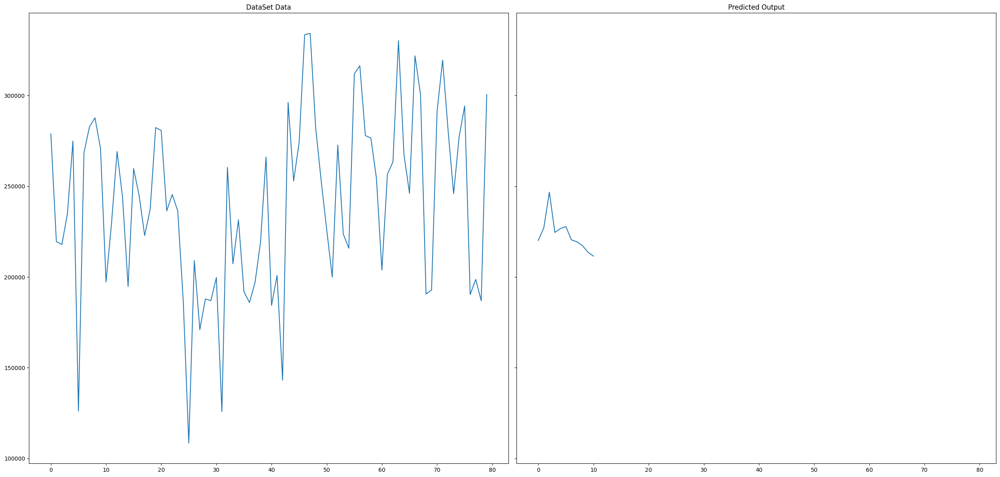


How do you want to get data???

1. Daily 2. Minutely 3. Weekly 4. Monthly 5. Hourly 6. Exit : 2

How much minute prediction you want : 70
Min  1 Power Consumption :[[406448.5]]
Min  2 Power Consumption :[[403694.7]]
Min  3 Power Consumption :[[401224.4]]
Min  4 Power Consumption :[[398674.28]]
Min  5 Power Consumption :[[396132.44]]
Min  6 Power Consumption :[[393630.94]]
Min  7 Power Consumption :[[391136.12]]
Min  8 Power Consumption :[[388657.38]]
Min  9 Power Consumption :[[386196.88]]
Min  10 Power Consumption :[[383751.53]]
Min  11 Power Consumption :[[381322.22]]
Min  12 Power Consumption :[[378908.94]]
Min  13 Power Consumption :[[376511.28]]
Min  14 Power Consumption :[[374129.38]]
Min  15 Power Consumption :[[371763.03]]
Min  16 Power Consumption :[[369412.12]]
Min  17 Power Consumption :[[367076.56]]
Min  18 Power Consumption :[[364756.3]]
Min  19 Power Consumption :[[362451.22]]
Min  20 Power Consumption :[[360161.16]]
Min  21 Power Consumption :[[357886.06]]
Min  22 Power

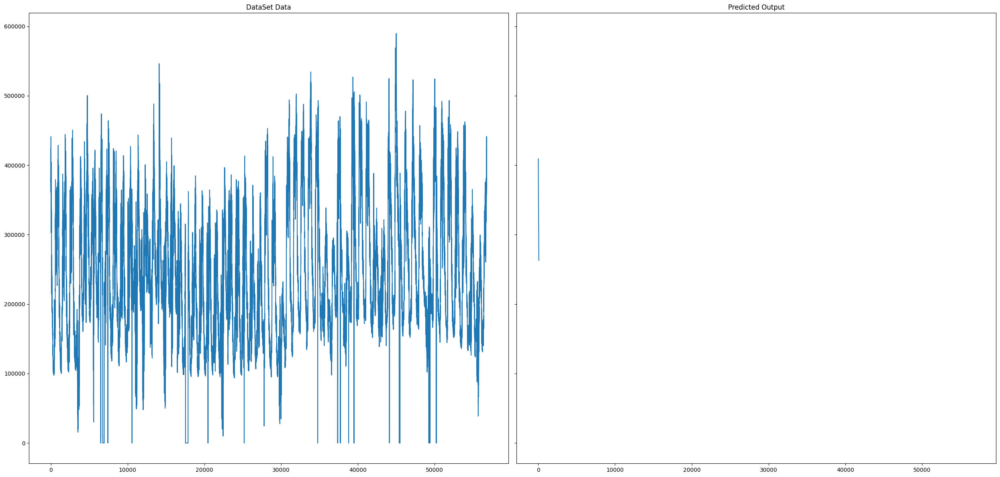


How do you want to get data???

1. Daily 2. Minutely 3. Weekly 4. Monthly 5. Hourly 6. Exit : 3

How many week prediction you want : 4
Week  1 Power Consumption :[[268019.97]]
Week  2 Power Consumption :[[273735.06]]
Week  3 Power Consumption :[[270232.88]]
Week  4 Power Consumption :[[277155.1]]


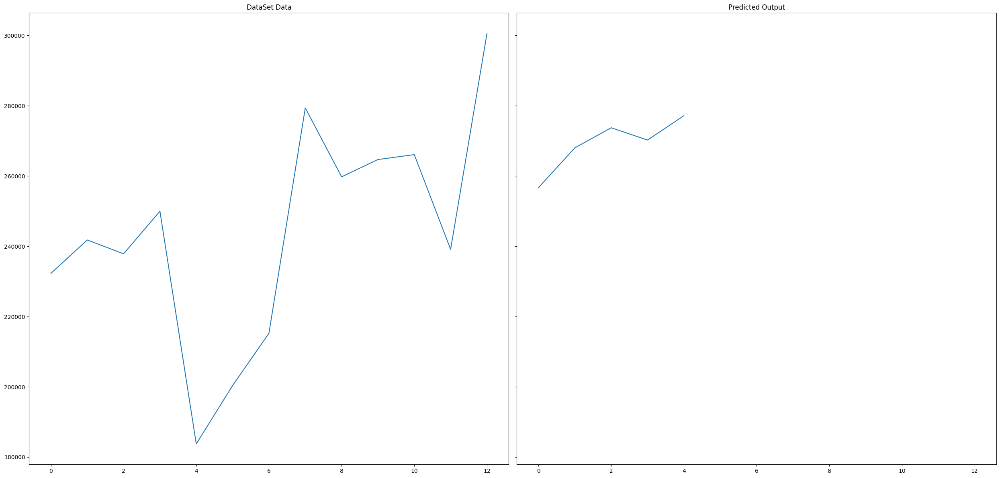


How do you want to get data???

1. Daily 2. Minutely 3. Weekly 4. Monthly 5. Hourly 6. Exit : 4

How many month prediction you want : 2
month  1 Power Consumption :[[36146.895]]
month  2 Power Consumption :[[50976.176]]


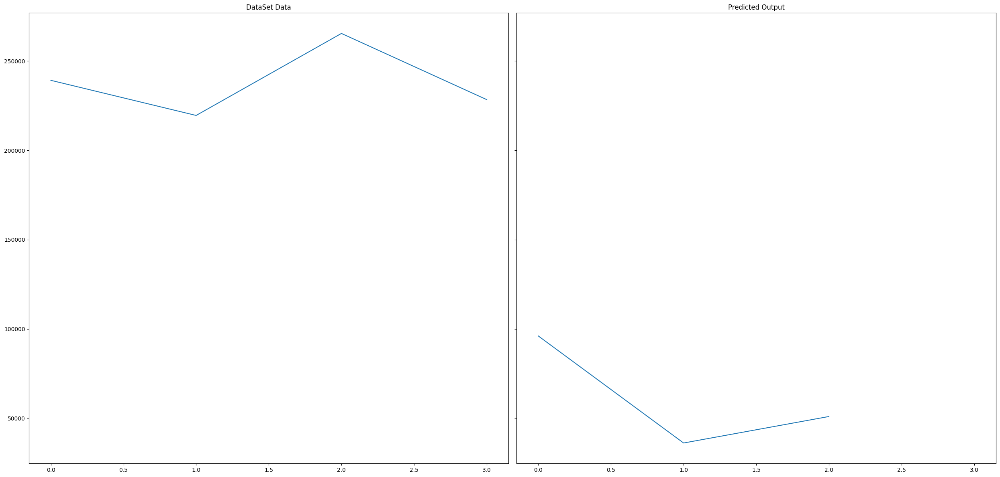


How do you want to get data???

1. Daily 2. Minutely 3. Weekly 4. Monthly 5. Hourly 6. Exit : 4

How many month prediction you want : 1
month  1 Power Consumption :[[36146.895]]


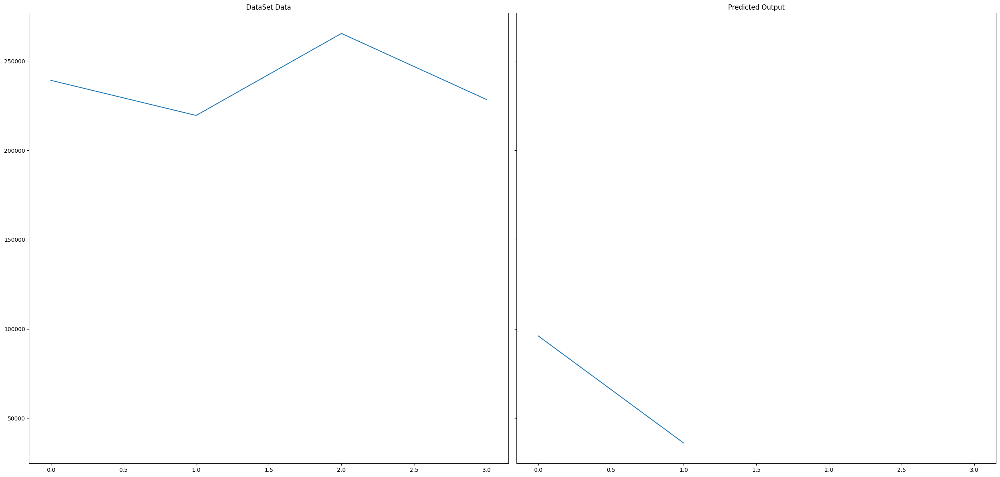


How do you want to get data???

1. Daily 2. Minutely 3. Weekly 4. Monthly 5. Hourly 6. Exit : 5

How many hour prediction you want : 100
Hour  1 Power Consumption :[[400500.78]]
Hour  2 Power Consumption :[[391988.8]]
Hour  3 Power Consumption :[[381723.8]]
Hour  4 Power Consumption :[[370622.34]]
Hour  5 Power Consumption :[[359209.4]]
Hour  6 Power Consumption :[[347819.62]]
Hour  7 Power Consumption :[[336644.97]]
Hour  8 Power Consumption :[[325768.06]]
Hour  9 Power Consumption :[[315218.16]]
Hour  10 Power Consumption :[[305001.12]]
Hour  11 Power Consumption :[[295113.03]]
Hour  12 Power Consumption :[[285546.03]]
Hour  13 Power Consumption :[[276290.8]]
Hour  14 Power Consumption :[[267337.7]]
Hour  15 Power Consumption :[[258677.03]]
Hour  16 Power Consumption :[[250299.39]]
Hour  17 Power Consumption :[[242195.55]]
Hour  18 Power Consumption :[[234356.55]]
Hour  19 Power Consumption :[[226773.72]]
Hour  20 Power Consumption :[[219438.7]]
Hour  21 Power Consumption :[[212343.

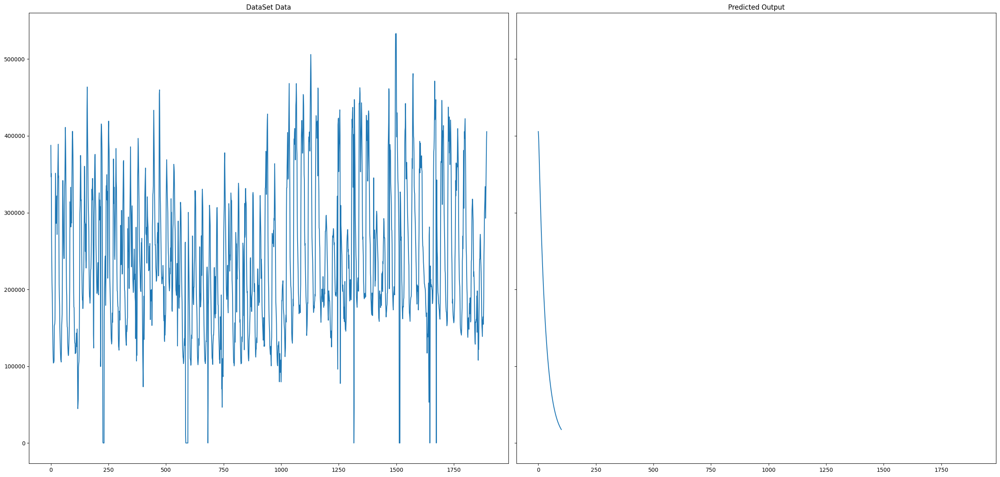


How do you want to get data???

1. Daily 2. Minutely 3. Weekly 4. Monthly 5. Hourly 6. Exit : 6

Thanks Sir...


In [61]:
while True:
    print("\nHow do you want to get data???")
    n = int(input("\n1. Daily 2. Minutely 3. Weekly 4. Monthly 5. Hourly 6. Exit : "))
    
    match n:
        case 1:
            x_input1 = timeseries_data_daily[-3:]
            lst_output=[]
            days = int(input("\nHow many days prediction you want : "))
            
            prediction(x_input1, "Day", days, model_daily,lst_output)
            
            f, (ax1, ax2) = plt.subplots(1, 2, sharex=True, sharey=True) 
            ax1.plot(timeseries_data_daily )
            ax1.set_title('DataSet Data')

            ax2.plot(lst_output)
            ax2.set_title('Predicted Output')
            
            plt.tight_layout()
            plt.show()
        
        case 2:
            x_input = timeseries_data_min[-3:]
            lst_output1=[]
            mins = int(input("\nHow much minute prediction you want : "))
            
            prediction(x_input, "Min", mins, model_min,lst_output1)
            f, (ax1, ax2) = plt.subplots(1, 2, sharex=True, sharey=True) 
            ax1.plot(timeseries_data_min)
            ax1.set_title('DataSet Data')

            ax2.plot(lst_output1)
            ax2.set_title('Predicted Output')
            
            plt.tight_layout()
            plt.show()
            
        case 3:
            x_input = timeseries_data_week[-3:]
            lst_output2=[]
            week = int(input("\nHow many week prediction you want : "))
            
            prediction(x_input, "Week", week, model_week,lst_output2)
            f, (ax1, ax2) = plt.subplots(1, 2, sharex=True, sharey=True) 
            ax1.plot(timeseries_data_week)
            ax1.set_title('DataSet Data')

            ax2.plot(lst_output2)
            ax2.set_title('Predicted Output')
            
            plt.tight_layout()
            plt.show()
        
        case 4:
            x_input = timeseries_data_month[-3:]
            lst_output3=[]
            month = int(input("\nHow many month prediction you want : "))
            
            prediction(x_input, "month", month, model_month,lst_output3)
            f, (ax1, ax2) = plt.subplots(1, 2, sharex=True, sharey=True) 
            ax1.plot(timeseries_data_month)
            ax1.set_title('DataSet Data')

            ax2.plot(lst_output3)
            ax2.set_title('Predicted Output')
            
            plt.tight_layout()
            plt.show()
        
        case 5:
            x_input = timeseries_data_hour[-3:]
            lst_output4=[]
            hour = int(input("\nHow many hour prediction you want : "))
            
            prediction(x_input, "Hour", hour, model_hour,lst_output4)
            f, (ax1, ax2) = plt.subplots(1, 2, sharex=True, sharey=True) 
            ax1.plot(timeseries_data_hour)
            ax1.set_title('DataSet Data')

            ax2.plot(lst_output4)
            ax2.set_title('Predicted Output')
            
            plt.tight_layout()
            plt.show()
            
        case 6:
            print("\nThanks Sir...")
            break
    

# univariate time series analysis

# LONG SHORT TERM MEMORY


In [62]:
#5 4 6 2 3 4 5 1    moving average
#feed   out_feed
#5 4 6    2
#4 6 2    3
#6 2 3    4
#2 3 4    5 
#3 4 5    1
#4 5 1    a
#5 1 a    b
#1 a b    c


#unsupervised learning
#low accuracy (10-20 days)
